<H1><center> E.D.A - Lucas </center></H1>

## Imports y funciones que vamos a usar para el analisis exploratorio

Librerias utilizadas:

- pandas
- numpy
- seaborn 
- matplotlib
- seaborn
- plotly
- sklearn

> En caso de no tener instalada alguna de las anteriores, descomentar la siguiente celda para descargarlas:

In [ ]:
#! pip install -r requirements.txt

> Imports

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.graph_objects as go
import plotly.express as px

In [2]:
df = pd.read_csv("heart_2020_cleaned.csv")

In [3]:
def stacked_bar_chart_with_percentages(df, column, target_variable):
    """
    Given a data frame, a column, and a target variable, plots a stacked bar chart with
    percentages labels of the target variable for each value of the passed column.
    """
    # Group the data by the column and target variable, and calculate the counts and percentages
    grouped_data = df.groupby([column, target_variable]).size().reset_index(name='counts')
    grouped_data['percentage'] = grouped_data.groupby(column)['counts'].apply(lambda x: round(100 * x / x.sum(),2))
    
    # Plot the stacked bar chart
    fig = px.bar(grouped_data, x=column, y='percentage', color=target_variable, barmode='stack',
                 text='percentage', labels={'percentage': 'Percentage (%)', column: column.capitalize()})
    
    # Update the layout
    fig.update_layout(title=f'Stacked Bar Chart of {target_variable.capitalize()} by {column.capitalize()}',
                      xaxis=dict(title=column.capitalize()), yaxis=dict(title='Percentage (%)'))
    
    # Show the plot
    fig.show()

In [4]:
def analyze_numerical(df, analisis, target):
    av = df[analisis]
    
    # basic description
    print("\n> Description for ", analisis, "\n")
    print(av.describe())
    
    # histogram
    print("\n> Histogram: \n")
    fig = px.histogram(av, labels={'value': 'Data', 'count': 'Frequency'})
    fig.show()
    
    # boxplot
    print("\n> Boxplot: \n")
    fig = px.box(av)
    fig.show() 
    
    # compare to target var, we use a stacked bar approach since target is categorical
    print("\n>", analisis, "VS.", target, "\n")
    fig = px.scatter(df, x=analisis, color=target)
    fig.show()
    
    print("\n>", analisis, "VS.", target, "- Histograma x Pos= RED / Neg = GREEN \n")
    color_map = {'Yes': 'red', 'No': 'green'}

    # Create the histogram
    fig, ax = plt.subplots()
    for color, group in df[[analisis, target]].groupby(target):
        group.plot.hist(ax=ax, alpha=0.5, label=color, color=color_map[color])

    # Set the axis labels and legend
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')
    ax.legend(title='Stroke')

    # Show the plot
    plt.show()

In [5]:
def analyze_categorical(df, analisis, target):
    av = df[analisis]
    
    # basic description
    print("\n> Description for ", analisis, "\n")
    print(av.describe())
    
    # bar charts
    print("\n> Bar Chart - Absolute values: \n")
    counts = av.value_counts(normalize=False)
    fig = px.bar(x=counts.index, y=counts.values)
    fig.update_layout(yaxis_title='Count')
    fig.update_layout(xaxis_title=analisis)
    fig.update_traces(texttemplate='%{y}', textposition='inside')
    fig.show()
    
    # Pie Charts
    print("\n> Pie Chart - Relative %: \n")
    percentages = av.value_counts(normalize=True) * 100
    fig = go.Figure(data=[go.Pie(labels=percentages.index, values=percentages.values)])
    fig.show()
    
    # Compare to target var, we use a stacked bar approach since target is categorical
    print("\n>", analisis, "VS.", target, "\n")    
    stacked_bar_chart_with_percentages(df, analisis, target)

## Sex 

Esta variable categorica nos indica el sexo de las personas para las cuales tenemos datos en nuestro dataset. Puede tomar dos valores

- Female (F)
- Male (M)

Estudiaremos si tenemos una muestra equilibrada en cuanto al sexo y tambien si existe algun tipo de relacion entre esta variable y la probabilidad de tener una enfermedad cardiaca.

In [6]:
df["Sex"]

0         Female
1         Female
2           Male
3         Female
4         Female
           ...  
319790      Male
319791      Male
319792    Female
319793    Female
319794    Female
Name: Sex, Length: 319795, dtype: object


> Description for  Sex 

count     319795
unique         2
top       Female
freq      167805
Name: Sex, dtype: object

> Bar Chart - Absolute values: 



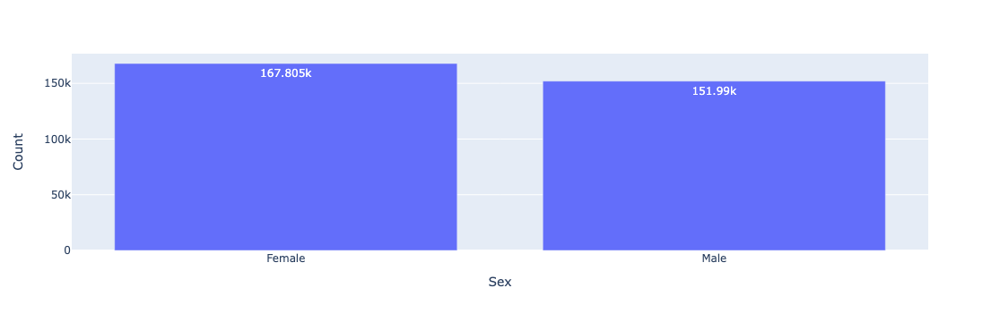


> Pie Chart - Relative %: 



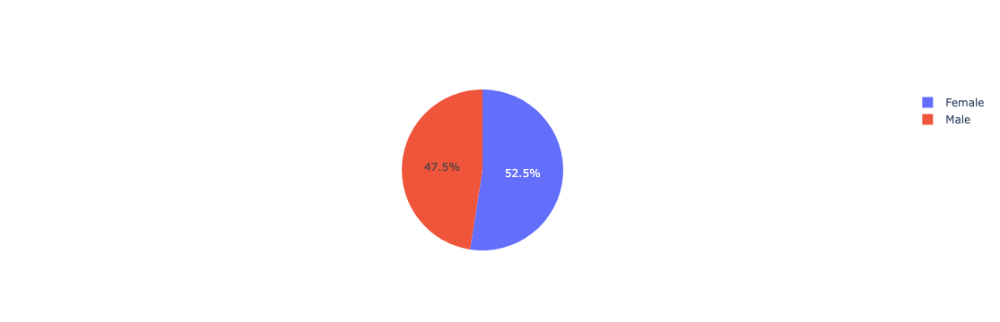


> Sex VS. HeartDisease 



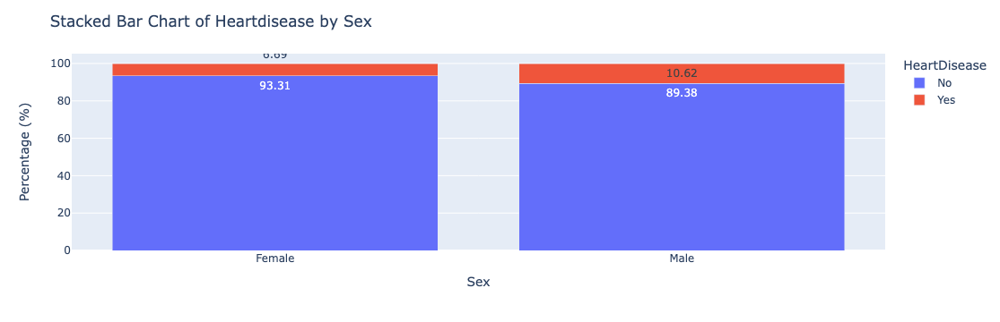

In [7]:
analyze_categorical(df, "Sex", "HeartDisease")

### Sobre la variable "SEX"

1) Lo primero que observamos es que nuestra base de datos tiene mas registros de mujeres que de hombres. Al rededor de 10mil registros mas. Representando un 47.5% del total los hombres y el 52.5% restante las mujeres

2) Vemos que la variable del sexo parece tener un impacto siginificativo sobre la probabilidad de padecer una enfermedad cardiaca. El porcentaje de casos positivos para los hombres es de casi el doble que el de las mujeres, por lo que esta variable nos podria servir para predecir si una persona va a tener o no una enfermedad del corazon. 

3) Seria interesante en futuros analisis entender si estas diferencias en los porcentajes de casos positivos se deben a caracteristicas fisioligicas / biologicas de cada sexo o a costumbres que las personas desarrollan durante su vida en funcion de su sexo y su contexto social. 

## AgeCategory

Esta variable, tambien categorica, agrupa a las personas del dataset en distintos rangos etareos. Analizaremos si existe alguna relacion entre estas categorias y la variable a predecir, enfermdad del corazon.


> Description for  AgeCategory 

count     319795
unique        13
top        65-69
freq       34151
Name: AgeCategory, dtype: object

> Bar Chart - Absolute values: 



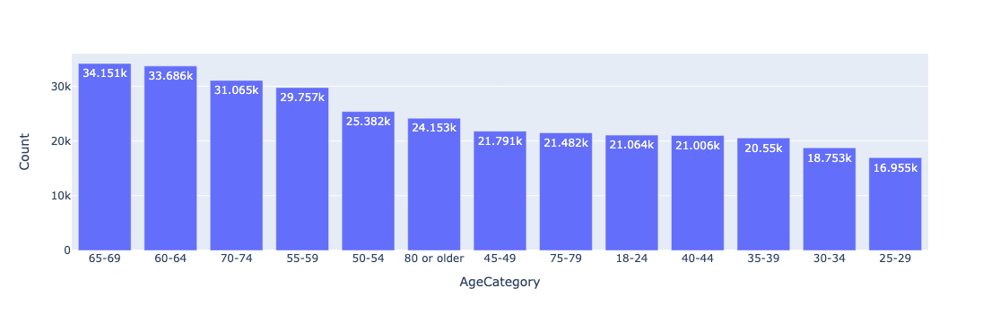


> Pie Chart - Relative %: 



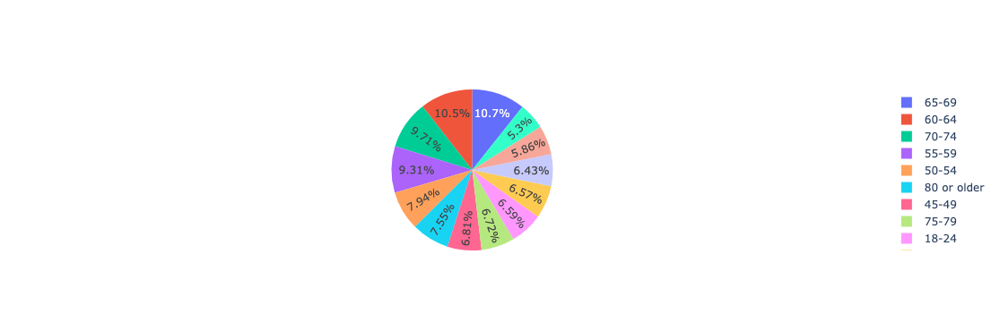


> AgeCategory VS. HeartDisease 



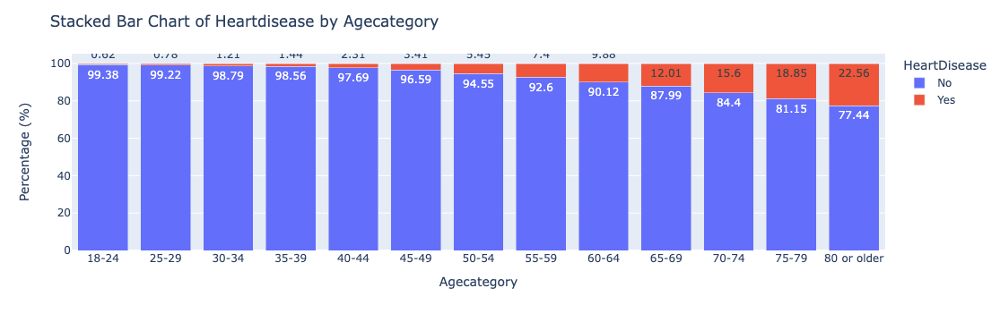

In [8]:
analyze_categorical(df, "AgeCategory", "HeartDisease")

### Sobre AgeCategory:

1) Vemos que la distribucion de nuestros datos es bastante representativa de las sociedades de paises desarrolados actuales, donde lo comun es observar una piramide poblacional con mayor cantidad de personas entre 30 y 60 años y menor cantidad:


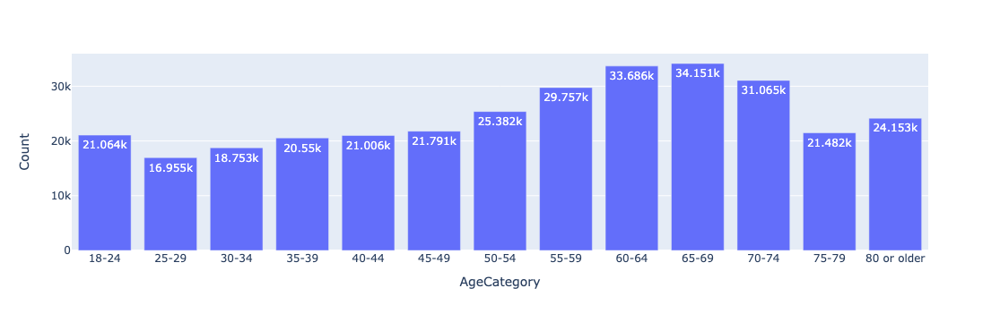

In [108]:
av = df["AgeCategory"]
counts = av.value_counts()
counts = counts.sort_index()

fig = px.bar(x=counts.index, y=counts.values)
fig.update_layout(yaxis_title='Count')
fig.update_layout(xaxis_title="AgeCategory")
fig.update_traces(texttemplate='%{y}', textposition='inside')
fig.show()

> Vemos una poblacion "envejecida", donde hay una gran cantidad de gente entre 5 y 74 años y una menor cantidad de gente joven. Algunos ejemplos de piramides poblacionales: [http://recursostic.educacion.es/secundaria/edad/3esohistoria/quincena5/swf/q5_contenidos_2b_1/index.htm]

> 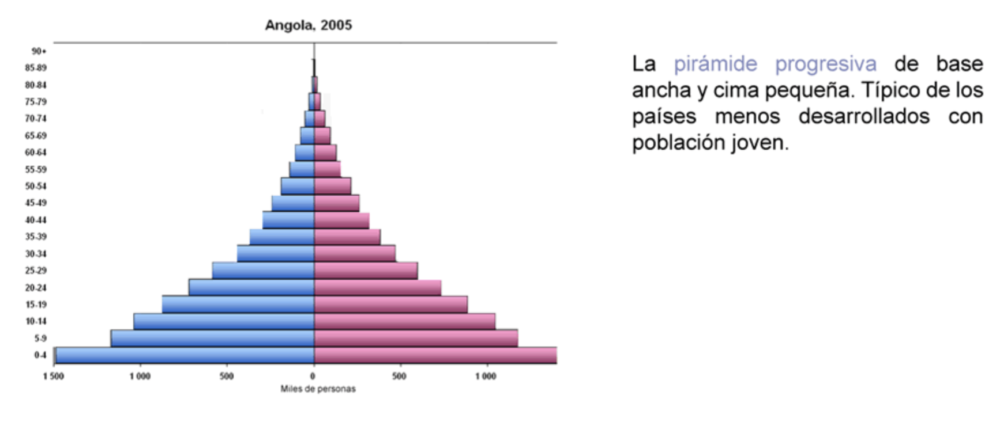
> 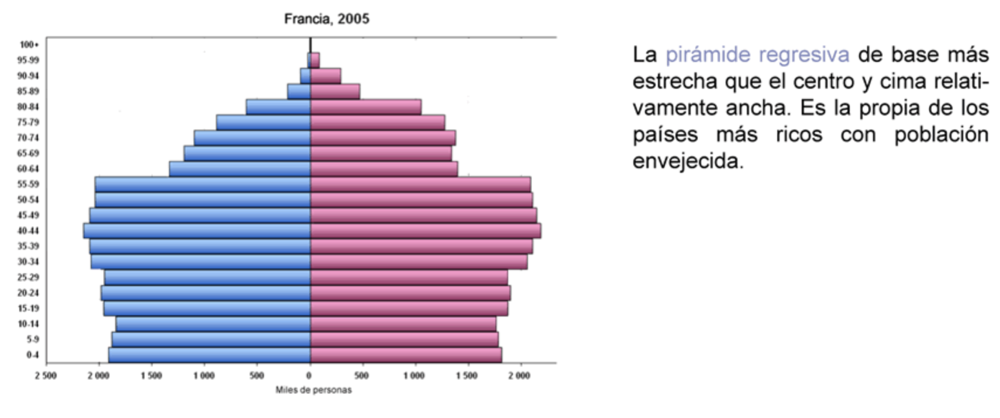

> Esta informacion puede ser util para conocer mas sobre la muestra sobre la cual estamos trabajando, aunque ya sabemos que se trata de datos obtenidos de Estados Unidos, si no lo supieramos podriamos inferir que se trata de datos obetenidos en un pais desarrollado, lo cual a futuro tambien podria brindarnos mayor informacion sobre los habitos de las personas. 

2) Lo segundo que notamos, y no por eso menos importante, es que se verifica la esperada relacion de Edad-Riesgo de enfermedad cardiaca. Como era de esperarse, vemos que existe una tendencia a que el riesgo aumente a medida que las personas van envejeciendo. Esto normalmente es de publico conocimiento y puede deberse a diversos factores medicos relacionados con la vejez. Seria interesante estudiar a futuro como impactan otras variables en rangos de edad altos [como por ejemplo el tabaquismo, el alcoholismo, o la actividad fisica] para ver como pueden mitigarse, o evitarse perjuicios mayores, de la edad sobre la salud. 

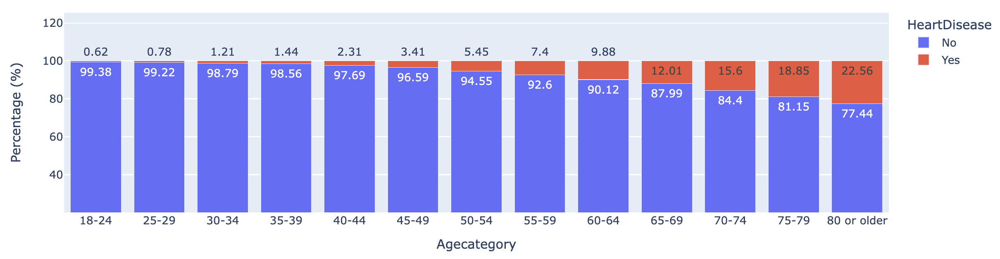

3. Discriminar entre categorias de edad le permitira a nuestro modelo predecir con mayor exactitud el riesgo de enfermedad del corazon.

## Race


Esta variable muestra la etnicidad de las personas que conforman nuestro dataset. Los valores que esta puede tomar son:

 - White
 - Black
 - Asian
 - American Indian/Alaskan Native
 - Other
 
 Veremos como se conforma nuestra muestra y tambien estudiaremos si existe alguna relacion entre alguna de estas categorias y la variable objetivo. En caso de que exista alguna relacion, seria pertinente realizar un estudio mas profundo que nos permita entender si existe alguna tradicion / comportamiento de la clase en cuestion que podria llegar a correlacionarse con un la probabilidad de Heart Disease.

In [9]:
df["Race"].unique()

array(['White', 'Black', 'Asian', 'American Indian/Alaskan Native',
       'Other', 'Hispanic'], dtype=object)


> Description for  Race 

count     319795
unique         6
top        White
freq      245212
Name: Race, dtype: object

> Bar Chart - Absolute values: 



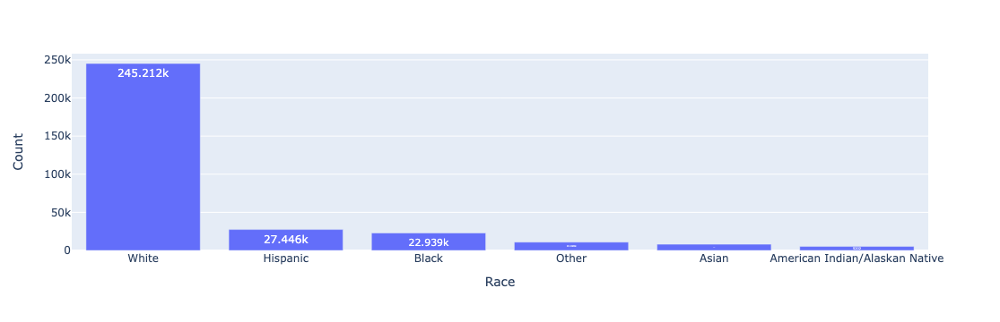


> Pie Chart - Relative %: 



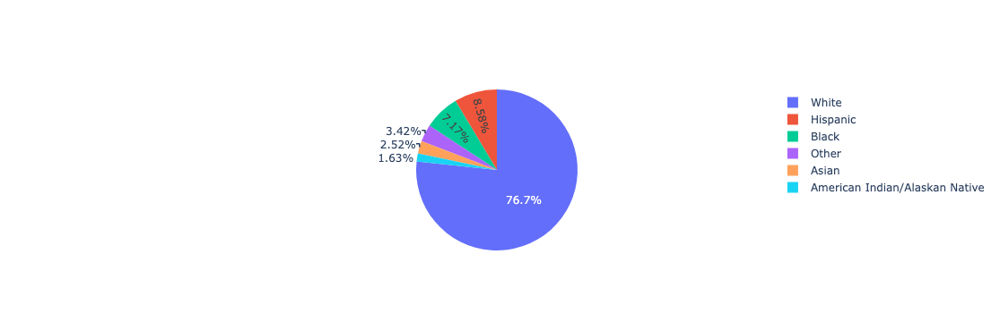


> Race VS. HeartDisease 



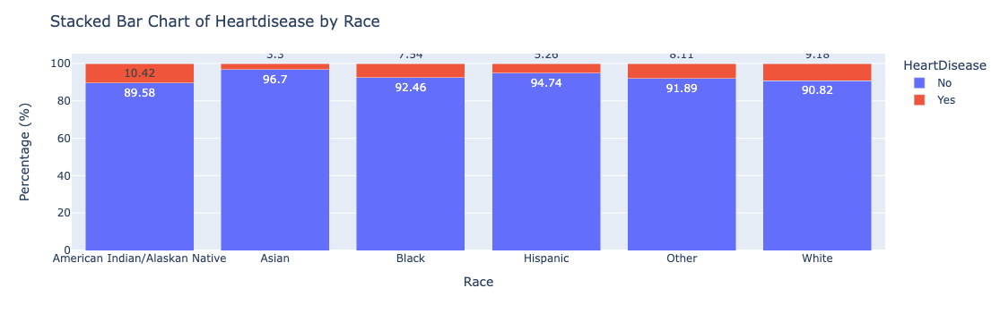

In [10]:
analyze_categorical(df, "Race", "HeartDisease")

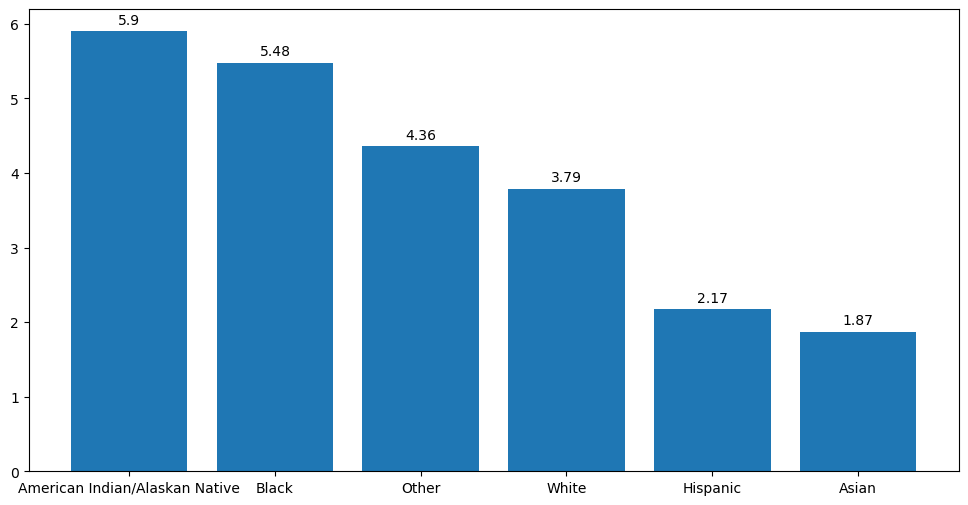

In [11]:
grouped_data = df.groupby(["Race", "Stroke"]).size().reset_index(name='counts')
grouped_data['percentage'] = grouped_data.groupby("Race")['counts'].apply(lambda x: round(100 * x / x.sum(),2))
grouped_data = grouped_data[grouped_data["Stroke"]=="Yes"]
grouped_data = grouped_data.sort_values(by="percentage", ascending = False)
                         
valores = grouped_data["percentage"]
labels = grouped_data["Race"]

fig, ax = plt.subplots(figsize=(12, 6))
bars = ax.bar(labels, valores)

for bar in bars:
    height = bar.get_height()
    ax.annotate(f'{height}', xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')



### Sobre Race

1) Vemos que nuestro dataset se compone en su mayoria por personas que caen dentro de la categoria "White", con un 76,7% de los casos, donde el siguiente en proporcion ("hispanic") tiene apenas un 8,58% de los casos. Esto nos brinda informacion, tambien, de como se compone la poblacion que estamos estudiando en este dataset. 

2) Vemos [Grafico de abajo] que las categorias de Race = "American Indian" y Race = "Black" son las que mayores cantidades de enfermedades cardiacas tienen en terminos porcentuales, mientras que Race = "Asian" presume la cantidad mas baja. Seria interesante entender cuales son los motivos de que esto suceda, existen diferencias de tradiciones, oportunidades, acceso a salud o eduacion, etc entre estas personas en la sociedad estudiada?

> 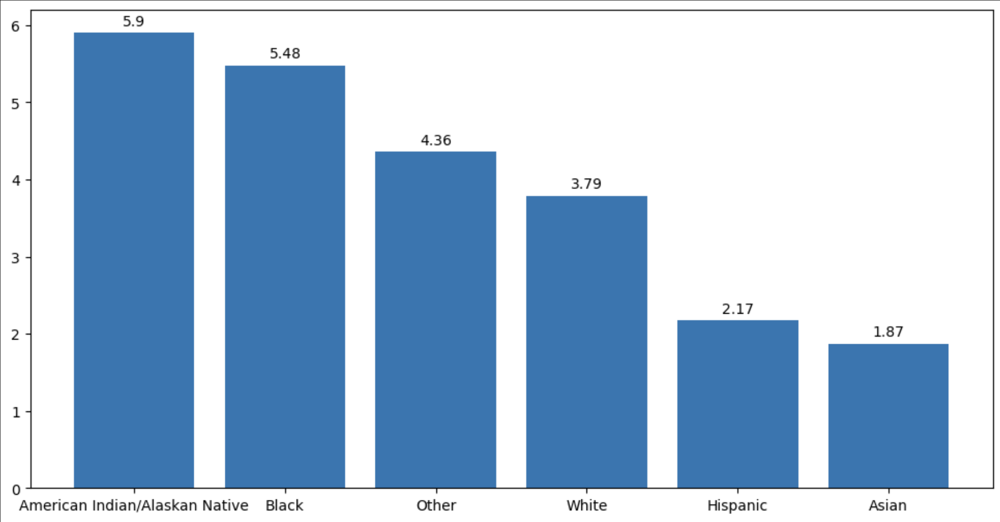

3) Los datos sugieren que la Raza podria ser un factor que agregue capacidad predictiva sobre el riesgo de enfermedad cardiaca cardiaco en esta poblacion. 

## Diabetic

Esta categoria nos indica si una persona tiene o no diabetes cronica, si tuvo durante el embarazo y tambien si es "borderline" diabetes. Los valores que toma la variable son:
    
- Yes
- No 
- No, borderline diabetes
- Yes (during pregnancy)

A priori, esperariamos ver que este campo tiene algun tipo de relacion con el riesgo de HeartDisease. Vamos a estudiarlo:

In [12]:
df["Diabetic"].unique()

array(['Yes', 'No', 'No, borderline diabetes', 'Yes (during pregnancy)'],
      dtype=object)


> Description for  Diabetic 

count     319795
unique         4
top           No
freq      269653
Name: Diabetic, dtype: object

> Bar Chart - Absolute values: 



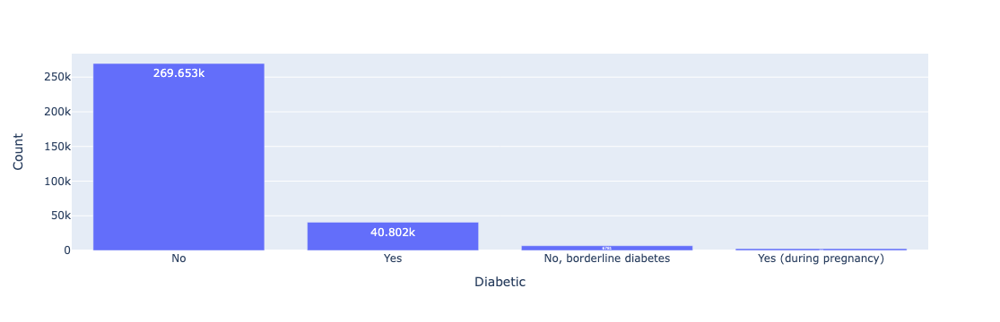


> Pie Chart - Relative %: 



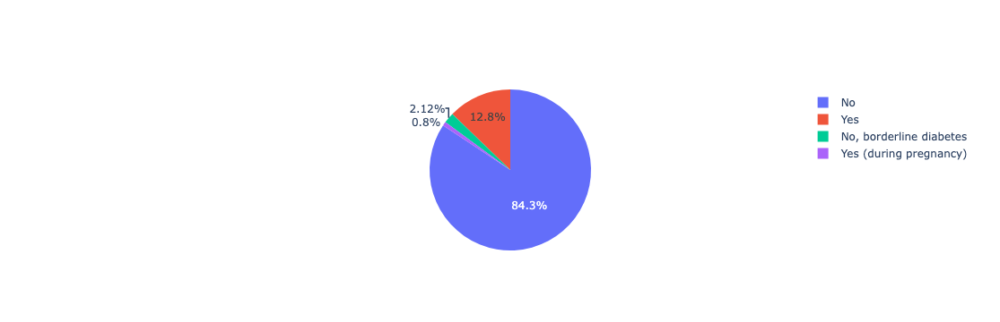


> Diabetic VS. HeartDisease 



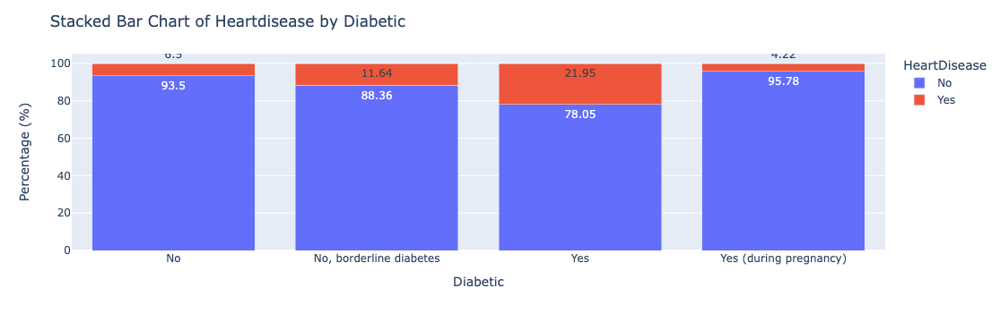

In [14]:
analyze_categorical(df, "Diabetic", "HeartDisease")

### Sobre Diabetes

1) Observamos que la gran mayoria de la gente de la muestra NO tiene diabetes. Tan solo el 13% de la gente SI tiene, y muy pocas personas tuvieron (0.8%) diabetes durante el embarazo. Existe un 4to grupo, con el 2.12% de los casos que NO tiene diabetes diagnosticada pero esta muy cerca de tenerla. 

2) Como era de esperarse, vemos que la gente CON diabetes, tiene la mayor probabilidad de HeartDisease con un porcentaje de positivos muy alto del 22%, seguida por la gente que NO tiene pero esta muy cerca de tenerla a nivel diagnostico (Borderline). Esto sera un buen predictor para nuestros modelos. 

3) Interesante notar que las personas que tuvieron diabetes durante el embarazo son las que menor cantidad de casos positivos presentan, incluso menos que las personas que nunca tuvieron. 

## PhysicalActivity

Variable binaria que indica si la persona realizo actividad fisica o no. Personas que reportan haber realizado actividad fisica en _los ultimos 30 dias_ o durante su dia a dia en el trabajo.

Estudiaremos si existe relacion (mayor o menor probabilidad) entre los casos positivos de infartos y el hacer o no deporte. 

A priori, comentamos que creemos que esta variable podria medirse mejor, generar categorias que midan el nivel de actividad fisica con una mayor granuralida, ya que con la medicion actual se esta tratando igual a una persona que hace deporte 1 vez por mes que a una persona que entrena 7 veces a la semana y es un atleta de alto rendimiento. Estas diferencias claramente tendrian un impacto sobre la salud cardiaca.

In [137]:
df["PhysicalActivity"].unique()

array(['Yes', 'No'], dtype=object)


> Description for  PhysicalActivity 

count     319795
unique         2
top          Yes
freq      247957
Name: PhysicalActivity, dtype: object

> Bar Chart - Absolute values: 



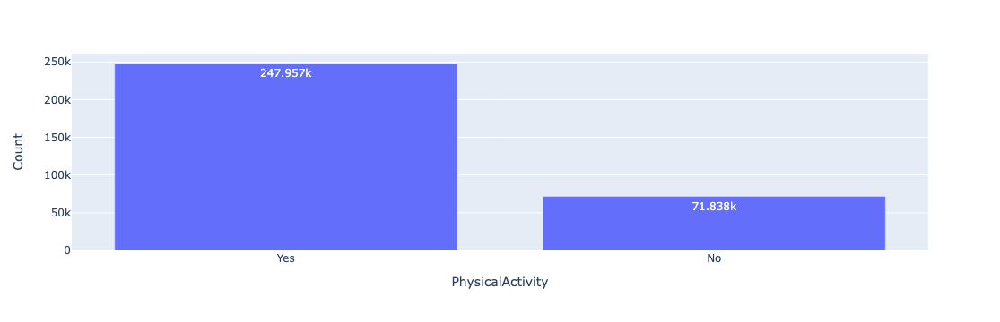


> Pie Chart - Relative %: 



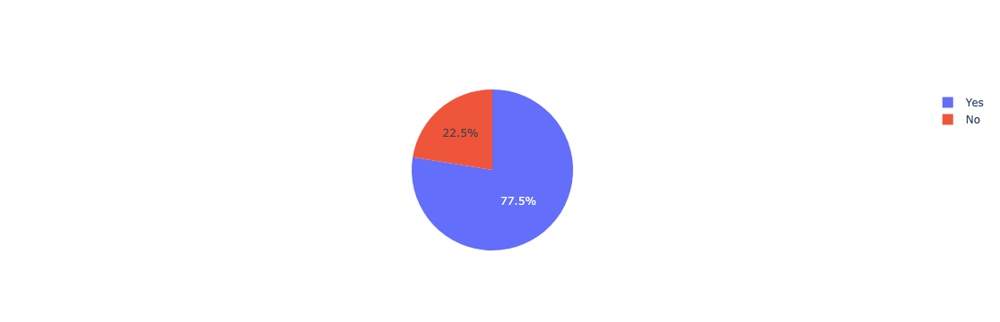


> PhysicalActivity VS. HeartDisease 



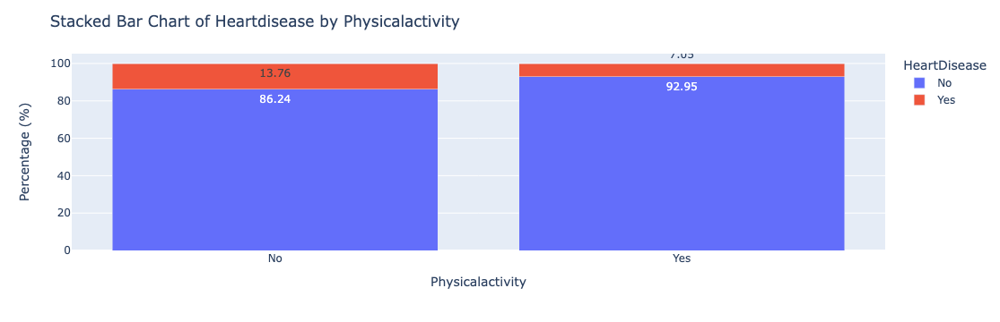

In [15]:
analyze_categorical(df, "PhysicalActivity", "HeartDisease")

### Sobre PhysicalActivity

1) Vemos que, relacionado con lo que comentabamos previamente, la mayoria de las personas realizo actividad fisica en los ultimos 30 dias _al menos una vez_

2) Si bien esta variable no representa bien el _grado de actividad fisica_ de las personas, lo que SI puede representar bien es a la gente que realiza **_realmente muy poca actividad fisica_** --> el 14% de los que caen en la categoria NO, son casos positivos de HeartDisease, casi 2 veces la cantidad de casos positivos que presentan las personas que SI hacen actividad fisica al menos una vez al mes. Por lo que esta variable tambien nos agrega un buen poder predictor sobre nuestra variable objetivo.


# <center> ----- FIN EDA LUCAS -----</center>

## Correlation Matrix

Usando el metodo .corr() para crear una matriz de correlacion entre las variables dummies creadas con one hot encoding:

In [ ]:
df = pd.read_csv("heart_2020_cleaned.csv")

<AxesSubplot:>

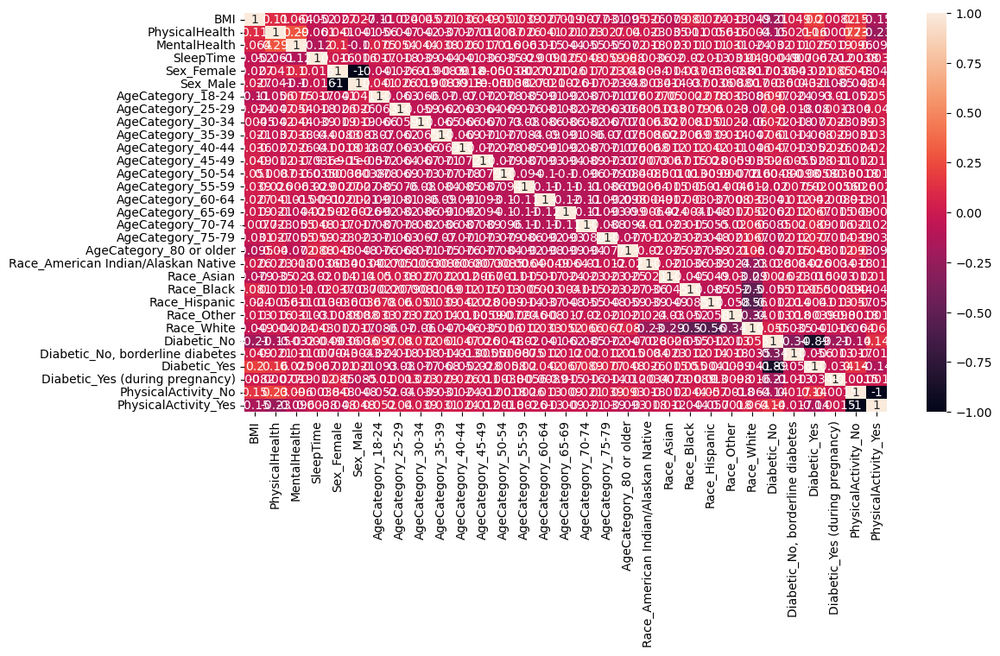

In [157]:
cols = ["Sex", "AgeCategory", "Race", "Diabetic", "PhysicalActivity"]
dummies = pd.get_dummies(df, columns = cols)
corr = dummies.corr()

plt.figure(figsize=(12, 6))

sns.heatmap(corr, annot=True)

Curiosidad
> Pandas' corr() method computes the correlation between numeric variables using Pearson correlation coefficient by default. However, when it comes to categorical variables, Pandas calculates the correlation in a different way.
When categorical variables are included in the correlation matrix, **Pandas computes the correlation between them using the Cramer's V statistic**, which is a measure of association between two nominal variables. Cramer's V is a value between 0 and 1, where 0 means no association and 1 means a perfect association.
To calculate the Cramer's V statistic, Pandas first constructs a contingency table for each pair of categorical variables in the DataFrame. A contingency table is a table that shows the frequency distribution of one variable in rows and another variable in columns. Then, it computes the chi-square statistic for the contingency table, which measures the degree of association between the two variables. Finally, it normalizes the chi-square statistic by dividing it by the square root of the product of the number of rows and columns in the contingency table, resulting in the Cramer's V statistic.
It is important to note that Cramer's V is a measure of association and not causation, and therefore, it does not imply any causal relationship between the categorical variables. Additionally, **Cramer's V is only applicable for nominal variables**, and other measures such as the Phi coefficient or the Tschuprow's T coefficient may be used for other types of categorical variables.

>In statistics and data analysis, a nominal variable is a categorical variable that has two or more categories or groups, but the categories have no intrinsic order or ranking. This means that the categories cannot be ordered or compared in a meaningful way.
For example, if we have a dataset of animals and their types, where the types are "dog", "cat", "bird", and "fish", then the variable "type" is a nominal variable. There is no intrinsic order to these categories, and we cannot say that "dog" is greater than "cat" or "bird" is less than "fish".

Calulating CHI-square categorical correlation test for categorical variables. If the p-value of the performed test is <0.05 then we can reject the null hypotesis and say that there is a relationship between the pair of variables.

In [254]:
def decide_on_p(val):
    try:
        val = float(val)
        color = 'red' if val < 0.05 else 'green'
        return 'color: %s' % color
    except:
        return 'color: %s' % 'green'

In [255]:
from itertools import product
import scipy.stats as ss

cat_var1 = ["Sex", "AgeCategory", "Race", "Diabetic", "PhysicalActivity", "Stroke"]
cat_var2 = ["Sex", "AgeCategory", "Race", "Diabetic", "PhysicalActivity", "Stroke"]

# Todas las posibles permutaciones
cat_var_prod = list(product(cat_var1,cat_var2, repeat = 1))
df_cat_v1 = df[cat_var2]
# Chi square test para cada par
result = []
for i in cat_var_prod:
    if i[0] != i[1]:
        obs = np.array(pd.crosstab(df_cat_v1[i[0]], df_cat_v1[i[1]]))
        chi = list(ss.chi2_contingency(obs))[1]
        result.append((i[0],i[1],chi))
chi_test_output = pd.DataFrame(result, columns = ["var1", "var2", "coeff"])
## Using pivot function to convert the above DataFrame into a crosstab
chi_test_output.pivot(index="var1", columns="var2", values="coeff")#.style.applymap(decide_on_p)


var2,AgeCategory,Diabetic,PhysicalActivity,Race,Sex,Stroke
var1,,,,,,
AgeCategory,NaN,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
Diabetic,0.0,NaN,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
PhysicalActivity,0.0,0.0,NaN,0.000000e+00,7.416586e-164,0.000000e+00
Race,0.0,0.0,0.000000e+00,NaN,3.546184e-111,5.079717e-113
Sex,0.0,0.0,7.416586e-164,3.546184e-111,NaN,8.208511e-02
Stroke,0.0,0.0,0.000000e+00,5.079717e-113,8.208511e-02,NaN


#### Correlation para numerical variables

<AxesSubplot:>

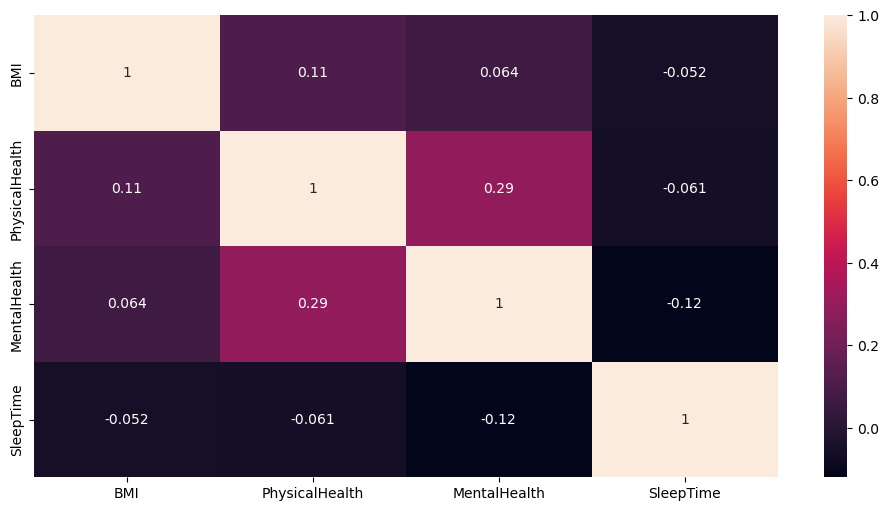

In [161]:
corr = df.corr()

plt.figure(figsize=(12, 6))

sns.heatmap(corr, annot=True)


> Description for  BMI 

count    319795.000000
mean         28.325399
std           6.356100
min          12.020000
25%          24.030000
50%          27.340000
75%          31.420000
max          94.850000
Name: BMI, dtype: float64

> Histogram: 



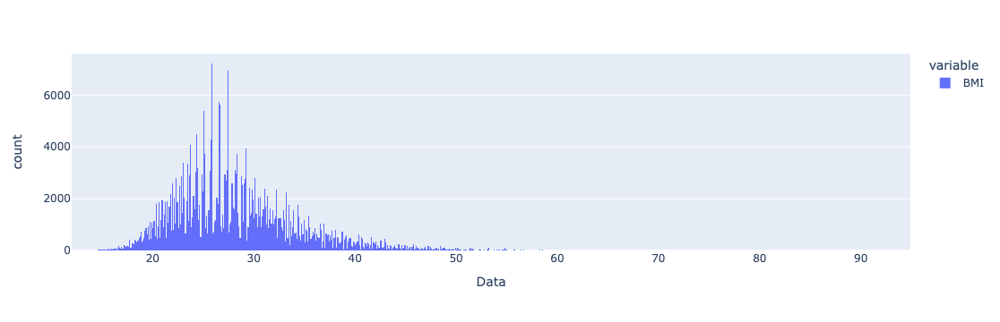


> Boxplot: 



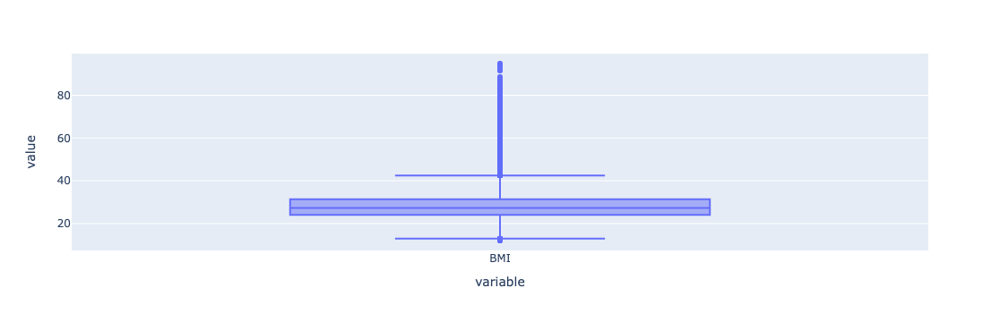


> BMI VS. Stroke 



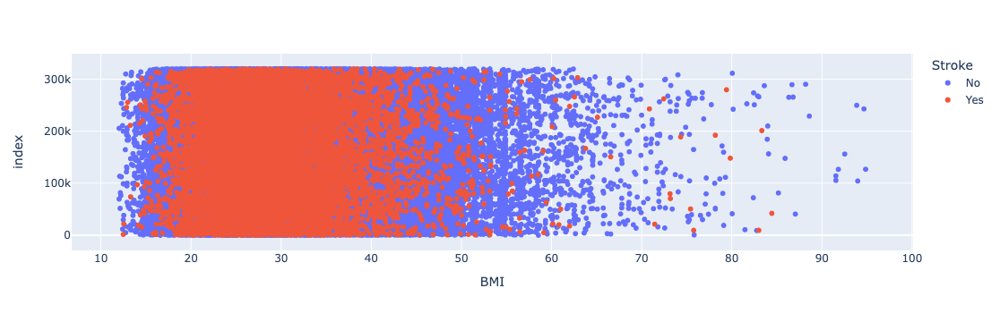


> BMI VS. Stroke - Histograma x Pos= RED / Neg = GREEN 



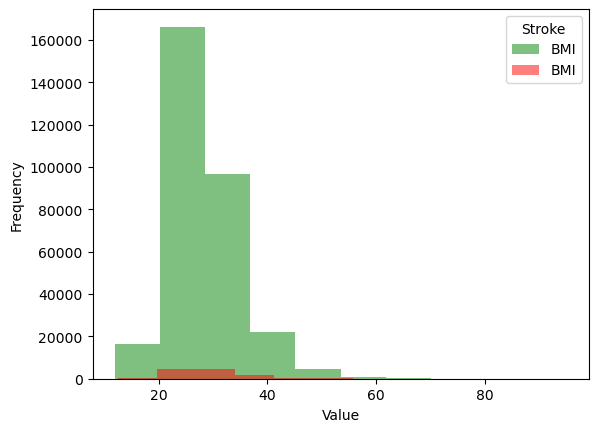

In [335]:
analyze_numerical(df, "BMI", "Stroke")


> Description for  AgeCategory 

count     319795
unique        13
top        65-69
freq       34151
Name: AgeCategory, dtype: object

> Bar Chart - Absolute values: 



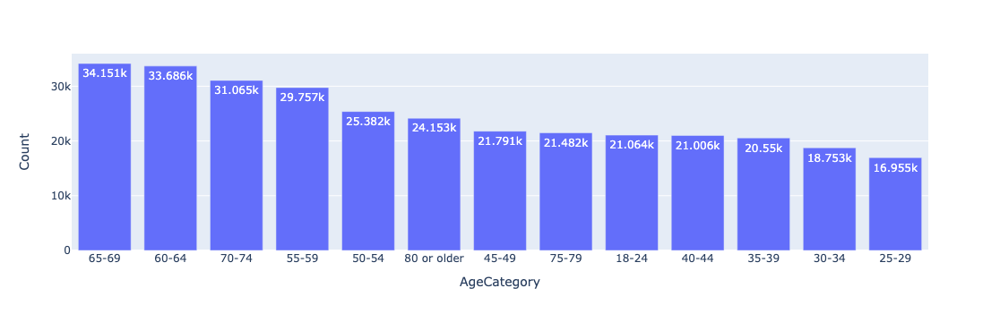


> Pie Chart - Relative %: 



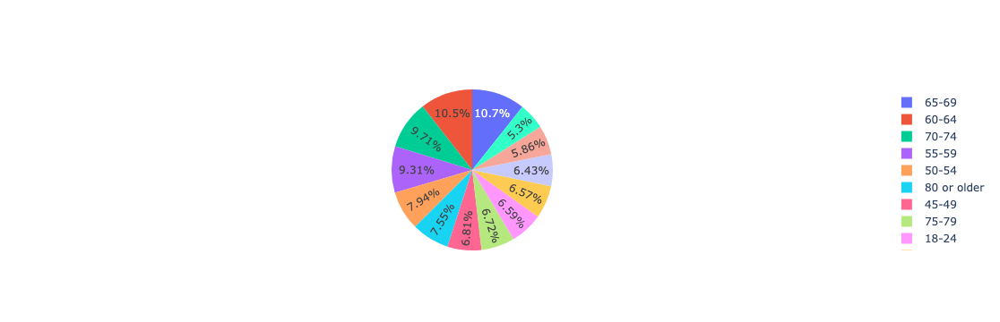


> AgeCategory VS. Stroke 



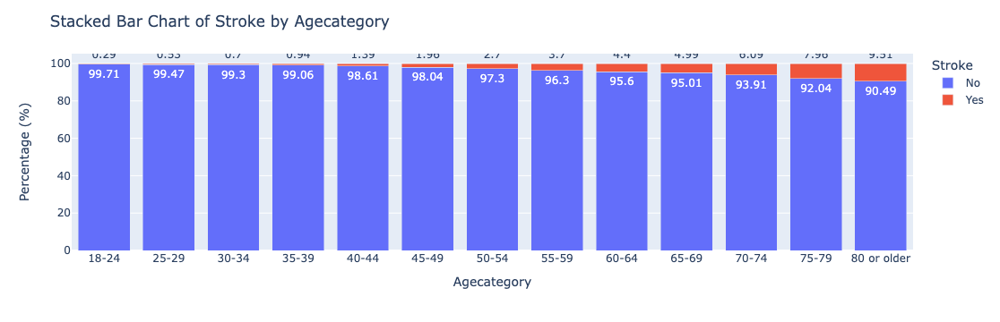

In [337]:
analyze_categorical(df, "AgeCategory", "Stroke")